# UMAPs Neurips samples, NK cells

in this notebook different markers to distinguish NK cells from innate lymhoid cells (ILCs) and gamma delta T cells (gd T) are tested. Markers are collected from recent publications. 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import anndata as ad
import scvi
import scanpy as sc
import umap

from ridgeplot import ridgeplot

import warnings

warnings.filterwarnings('ignore')



Global seed set to 0
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/Users/tiinatuononen/opt/anaconda3/envs/tiina-env/lib/python3.10/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


In [2]:
#Neurips
adata_neurips = sc.read_h5ad('/Users/tiinatuononen/Desktop/Thesis/Project/data/adata_neurips_norm_outer.h5ad')

In [3]:
adata_neurips

AnnData object with n_obs × n_vars = 80998 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [4]:
#To find gene names

result = [i for i in adata_neurips.var_names if i.startswith('GZ')]
print(result)

['GZF1', 'GZMA', 'GZMB', 'GZMH', 'GZMK', 'GZMM']


In [5]:
adata_neurips.obs['cell_type'].unique().tolist()

['NK',
 'CD8+ T CD69+ CD45RA+',
 'NK CD158e1+',
 'HSC',
 'CD14+ Mono',
 'B1 B IGKC+',
 'CD4+ T activated',
 'CD8+ T CD69+ CD45RO+',
 'G/M prog',
 'Naive CD20+ B IGKC-',
 'CD8+ T CD49f+',
 'Naive CD20+ B IGKC+',
 'CD4+ T naive',
 'CD8+ T naive',
 'CD4+ T activated integrinB7+',
 'cDC2',
 'gdT TCRVD2+',
 'CD8+ T TIGIT+ CD45RO+',
 'CD16+ Mono',
 'Erythroblast',
 'MAIT',
 'T reg',
 'gdT CD158b+',
 'Transitional B',
 'Proerythroblast',
 'CD8+ T CD57+ CD45RO+',
 'Plasmablast IGKC+',
 'ILC1',
 'Lymph prog',
 'ILC',
 'MK/E prog',
 'Normoblast',
 'CD8+ T CD57+ CD45RA+',
 'pDC',
 'B1 B IGKC-',
 'Plasma cell IGKC-',
 'Plasmablast IGKC-',
 'Plasma cell IGKC+',
 'CD8+ T TIGIT+ CD45RA+',
 'CD8+ T naive CD127+ CD26- CD101-',
 'CD4+ T CD314+ CD45RA+',
 'cDC1',
 'T prog cycling',
 'dnT']

In [6]:
#Both NK cell types selected


neurips_nk = adata_neurips[(adata_neurips.obs['cell_type'] == "NK") | (adata_neurips.obs['cell_type'] == "NK CD158e1+")]

In [7]:
neurips_nk

View of AnnData object with n_obs × n_vars = 7388 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [8]:
neurips_nk_prot=neurips_nk.obsm['protein_expression_clr_neurips']

In [9]:
#To exclude columns that contain only zeros

neurips_nk_prot = pd.DataFrame(neurips_nk_prot)
neurips_nk_prot != 0
(neurips_nk_prot != 0).any(axis=0)
neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]
neurips_nk_prot = neurips_nk_prot.loc[:, (neurips_nk_prot != 0).any(axis=0)]

In [10]:
samples=adata_neurips.obs['POOL'].unique().tolist()

In [11]:
#selecting one sample from Neurips

eg=adata_neurips[adata_neurips.obs['POOL'] == "s4d1"]


In [12]:
eg

View of AnnData object with n_obs × n_vars = 4885 × 21720
    obs: 'GEX_n_genes_by_counts', 'GEX_pct_counts_mt', 'GEX_size_factors', 'GEX_phase', 'ADT_n_antibodies_by_counts', 'ADT_total_counts', 'ADT_iso_count', 'cell_type', 'batch', 'ADT_pseudotime_order', 'GEX_pseudotime_order', 'Samplename', 'Site', 'DonorNumber', 'Modality', 'VendorLot', 'DonorID', 'DonorAge', 'DonorBMI', 'DonorBloodType', 'DonorRace', 'Ethnicity', 'DonorGender', 'QCMeds', 'DonorSmoker', 'is_train', 'n_genes', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden_r2', 'leiden_r2_n_genes_MAD_diff', 'leiden_r2_n_counts_MAD_diff', 'leiden_r2_percent_mito_MAD_diff', 'filter', 'model_group', 'BATCH', 'POOL', 'SAMPLE_SET', 'SAMPLE_TYPE', 'SAMPLE_TISSUE', 'DIAGNOSIS', 'SUBTYPE', 'STATUS'
    obsm: 'ADT_X_pca', 'ADT_X_umap', 'ADT_isotype_controls', 'GEX_X_pca', 'GEX_X_umap', 'X_pca', 'X_totalVI', 'X_umap', 'protein_expression', 'protein_expression_clr_neurips'
    layers: 'counts'

In [13]:
prot=eg.obsm['protein_expression_clr_neurips']

In [14]:
prot

,CD86,CD274,CD270,CD155,CD112,CD47,CD48,CD40,CD154,CD52,...,HLA-E,CD82,CD101,CD88,CD224,CD197,CD34,CD10,CD90,CD15
GTAGTACCAATCCTTT-1-s4d1,0.652674,1.447594,1.489354,0.890243,1.290341,1.988618,1.733474,0.850004,1.531390,0.694828,...,1.532575,0.614600,0.900688,1.389844,0.918109,0.0,0.0,0.0,0.0,0.0
CTCAAGAGTCACAGAG-1-s4d1,0.652674,1.069339,1.657770,0.890243,1.377072,1.264995,1.863027,1.101769,1.562259,1.072649,...,1.283465,0.614600,1.786480,0.762359,1.112478,0.0,0.0,0.0,0.0,0.0
CTGTGGGTCATGCGGC-1-s4d1,0.378666,1.132949,1.153412,0.730824,1.195368,1.546005,1.090567,1.173337,1.303511,1.013739,...,1.344431,0.353792,0.860303,0.979461,1.147198,0.0,0.0,0.0,0.0,0.0
CGTGATAGTTATCTGG-1-s4d1,0.000000,1.249182,1.335424,1.256332,2.674106,1.322314,0.289336,1.240123,1.397398,1.525053,...,0.859205,1.527772,0.629556,0.854928,1.000442,0.0,0.0,0.0,0.0,0.0
AGATCCAAGATCGGTG-1-s4d1,2.784459,1.132949,1.674846,1.669058,1.663981,2.101246,2.112640,1.417276,1.884321,1.861734,...,1.429432,1.031029,2.808629,2.007436,2.064066,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TAGATCGTCTCTATAC-1-s4d1,0.000000,1.132949,1.358918,1.523729,1.195368,1.312986,1.077960,1.173337,1.690467,1.013739,...,1.482333,0.353792,0.576253,1.157734,1.304730,0.0,0.0,0.0,0.0,0.0
AAGACTCAGGGCAAGG-1-s4d1,0.652674,1.302596,1.208881,0.541080,1.090419,1.589583,1.436578,1.240123,1.379313,0.561056,...,1.149104,0.614600,0.818218,1.189870,1.180752,0.0,0.0,0.0,0.0,0.0
CGAGAAGCACCTCGTT-1-s4d1,0.378666,0.764571,1.208881,0.730824,1.494512,1.944753,2.308527,0.941152,1.342130,1.231042,...,1.184424,0.773465,0.939506,1.017749,1.112478,0.0,0.0,0.0,0.0,0.0
TATCCTAGTTCTCCTG-1-s4d1,0.000000,1.302596,1.286711,0.890243,1.377072,1.150531,0.882414,1.469979,1.649530,0.607664,...,1.401893,1.405442,0.860303,1.124532,1.304730,0.0,0.0,0.0,0.0,0.0


In [15]:
prot=prot.rename(columns={'CD2': 'CD2_prot','KLRG1': 'KLRG1_prot', 'CX3CR1': 'CX3CR1_prot', 'CD52': 'CD52_prot','CD69': 'CD69_prot', 'CD226':'CD226_prot', 'TIGIT':'TIGIT_prot', 'CD27':'CD27_prot', 'CD38': 'CD38_prot', 'CD224': 'CD224_prot', 'CD7': 'CD7_prot', 'CD44': 'CD44_prot', 'CD34': 'CD34_prot','CD5': 'CD5_prot'})


In [16]:
#some proteins and genes have same names, here _prot added after protein names

a = eg.obs
b = prot

adata_eg=pd.concat([a, b], axis=1)
eg.obs=adata_eg


In [17]:
#selecting NK cells, gd T cells and ILCs

sample_nk = eg[(eg.obs['cell_type'] == "NK") | (eg.obs['cell_type'] == "NK CD158e1+") | (eg.obs['cell_type'] == "ILC") | (eg.obs['cell_type'] == "gdT CD158b+")]   


In [18]:
#Computing a neighborhood of observations using latent space

sc.pp.neighbors(adata_neurips, use_rep="X_totalVI")   #indicated representation

sc.tl.umap(adata_neurips)

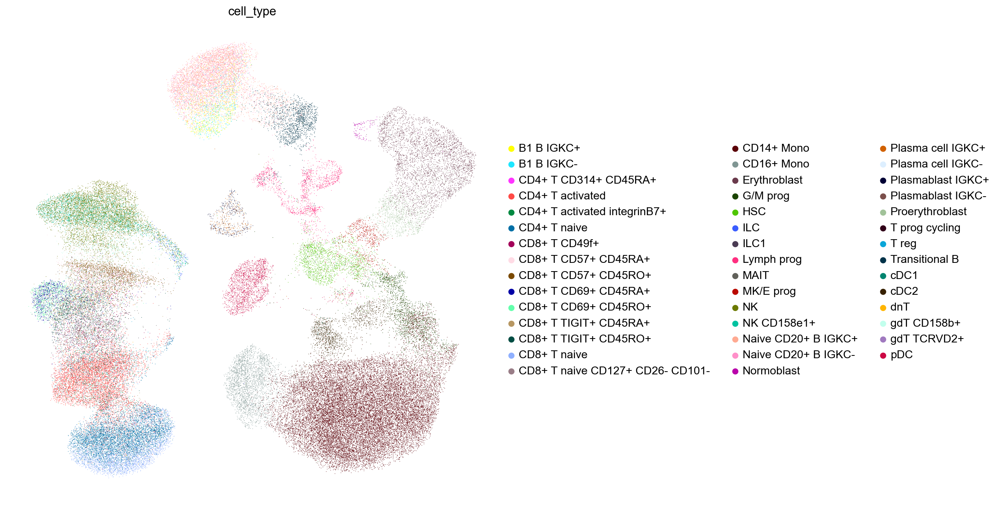

In [19]:
#Whole Neurips dataset, coloured by annotated cell types

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(adata_neurips, color = ['cell_type'], frameon = False)

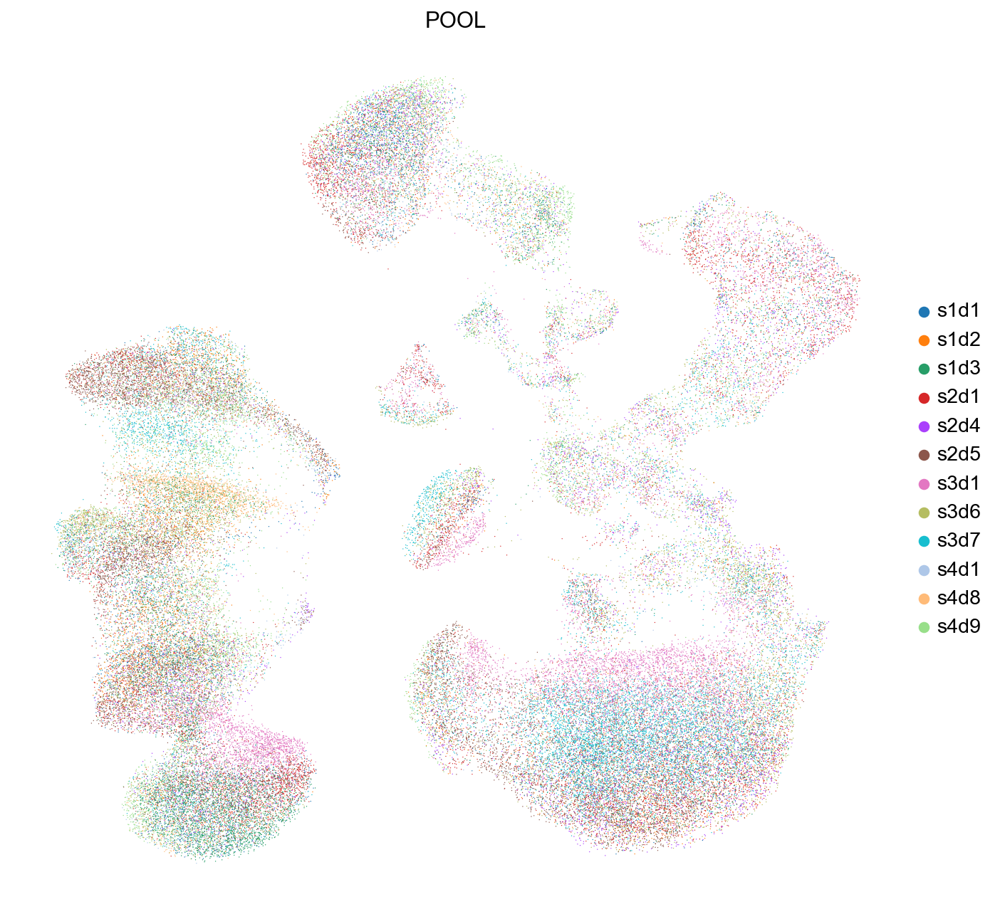

In [20]:
#Whole neurips dataset, coloured by samples

sc.pl.umap(adata_neurips, color = ['POOL'], frameon = False)

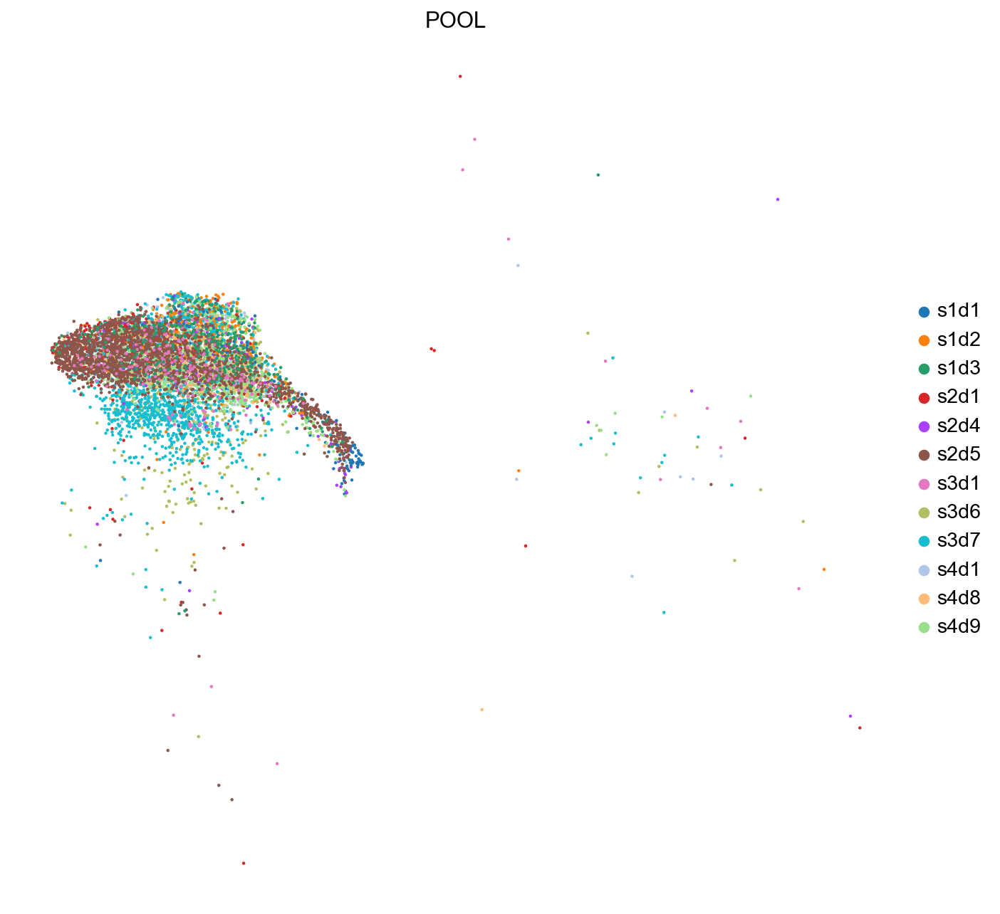

In [21]:
#All samples, but only selected cell types (NK, ILC and gd T cells)

sc.pl.umap(neurips_nk, color = ['POOL'], frameon = False)

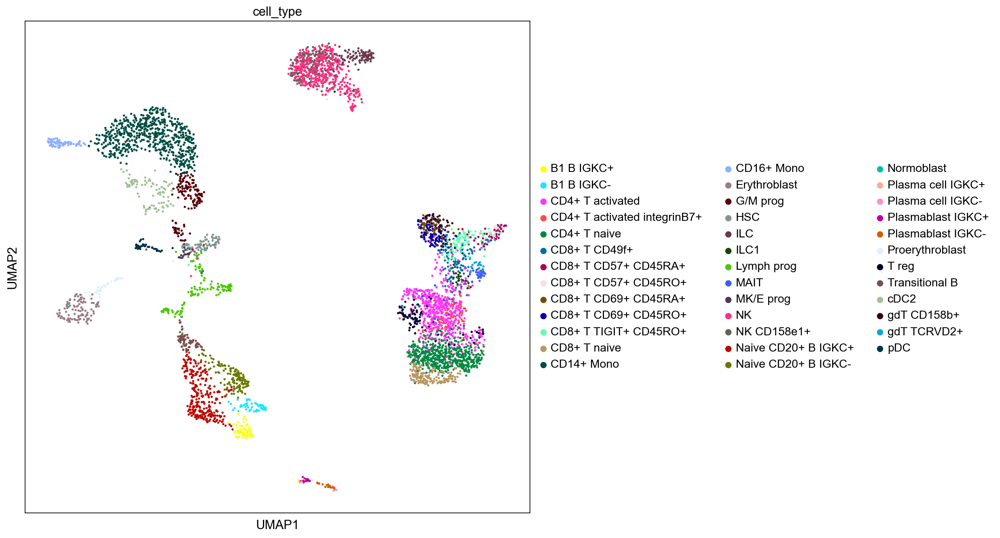

In [22]:
#only one sample

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(eg, color = ['cell_type'])

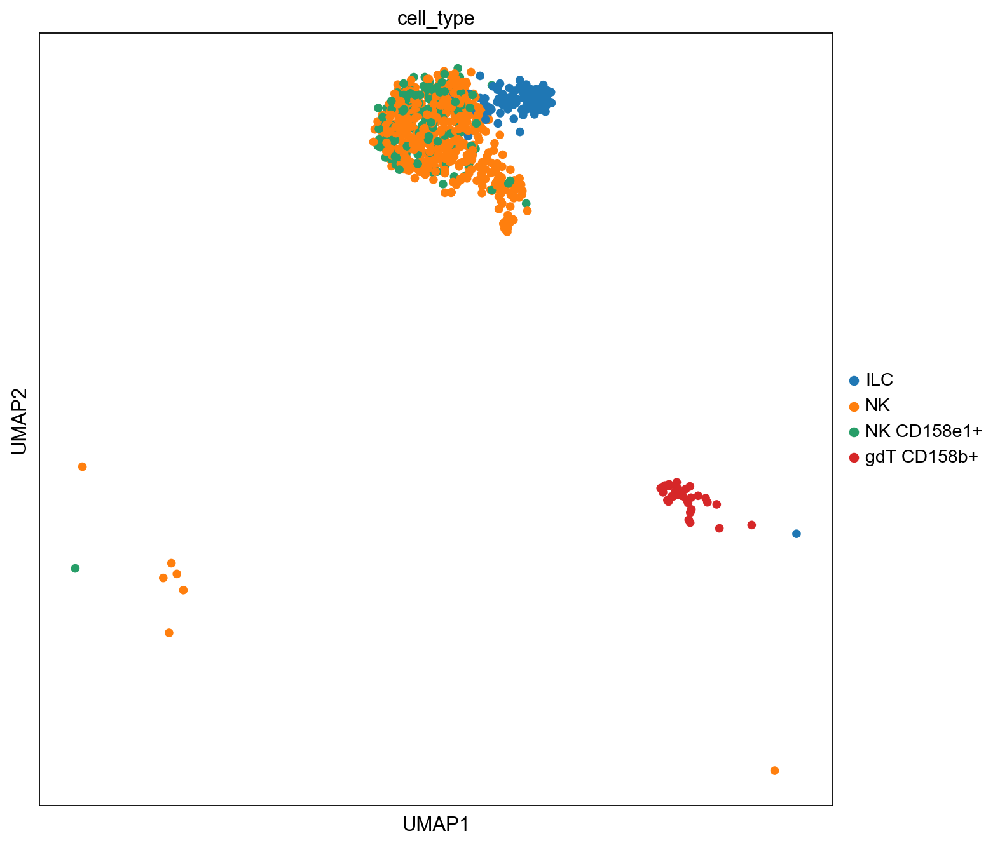

In [23]:
sc.pl.umap(sample_nk, color = ['cell_type'])

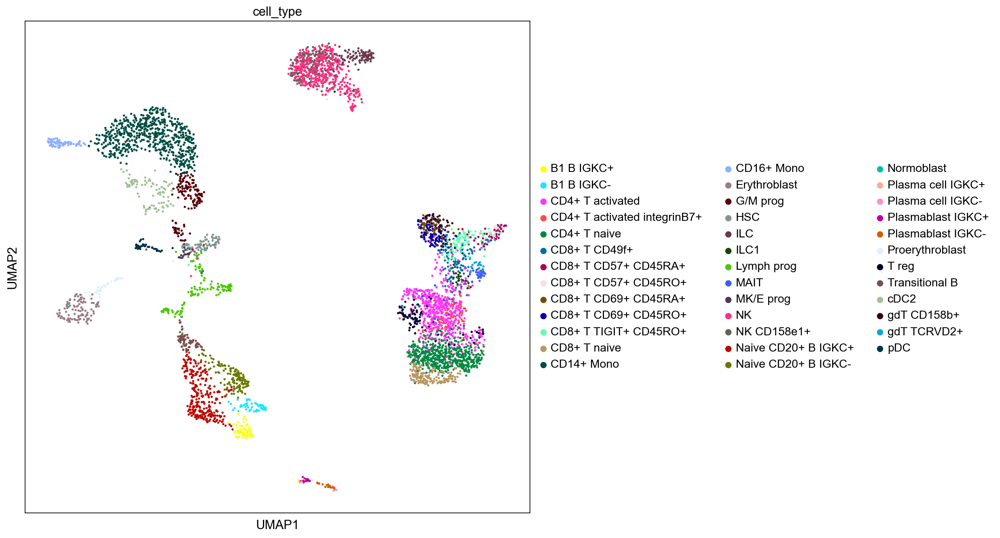

In [24]:
#only one sample

sc.set_figure_params(figsize=(10, 10))

sc.pl.umap(eg, color = ['cell_type'])

# Separation from ILC and gd T cells

- Innate lymphoid cells (ILCs) originates from common lymphoid progenitor (CLP) cells with B and T cells, but are lacking clonotypic antigen receptors. In contrast to these adaptive immune cells, ILCs are early effectors of immune response (respod within hours)
- ILCs can be divided into 3-5 groups (depending on reference) by their transcription factor expression and cytokine secretion . When dividing ILCs into 3 groups, these groups represent corresponding T helper cell subsets (Th1, Th2 and Th17) and share same cytokine profiles. In some sources, group 1 and 3 are divided into subgroups. 
- ILCs represent innate homologues to  of differentiated effector T cells?
- NK cells are concidered as group 1 ILCs. NK cells and other group 1 IlCs secrete IFNγ and express T-bet, and NK cells additionally express EOMES. 



- Based on UMAPs, some of the ILCs (as well as gd T cells) locate nearby NK cells. To separate these cell types, different markers are tested in the following code cell. 

## Neurips documentation

github:  https://github.com/openproblems-bio/neurips2021-notebooks



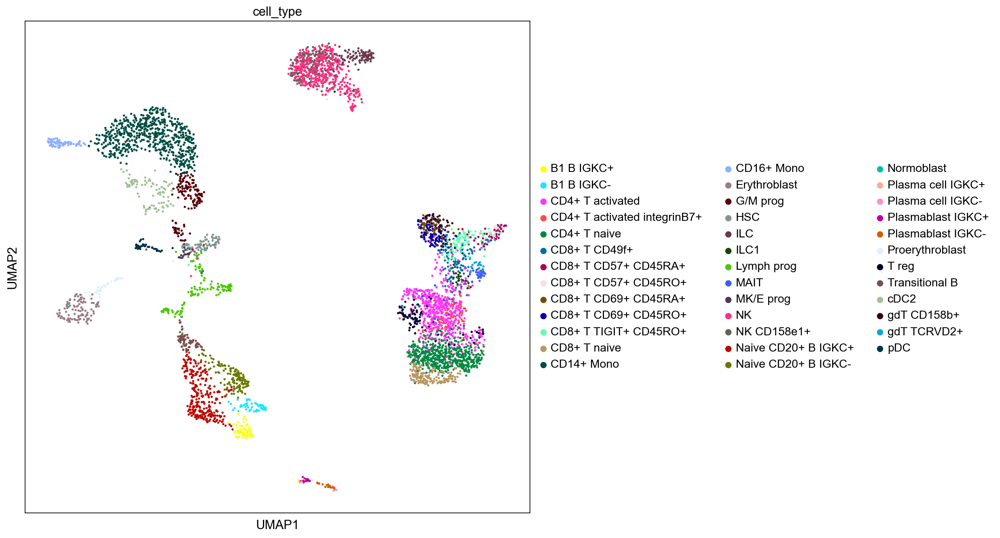

NK markers, RNA


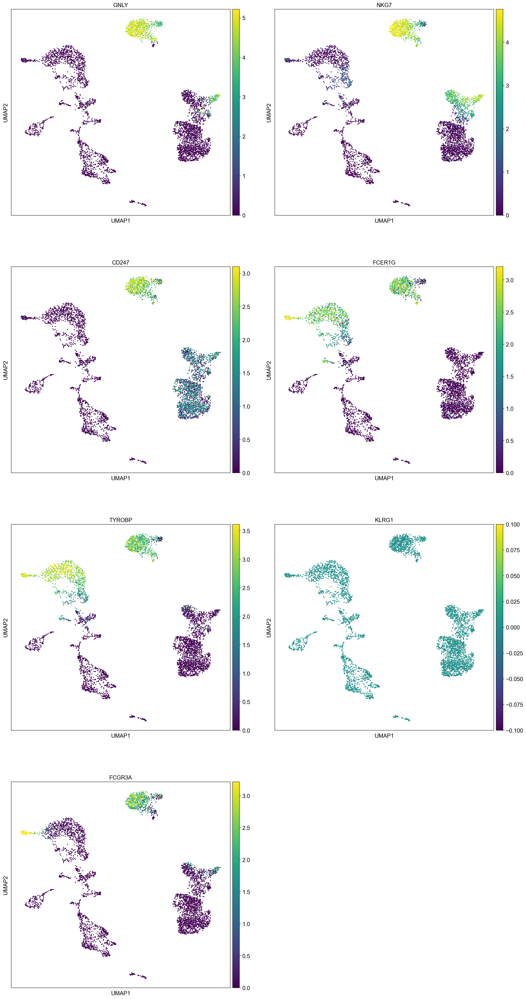

NK markers, protein


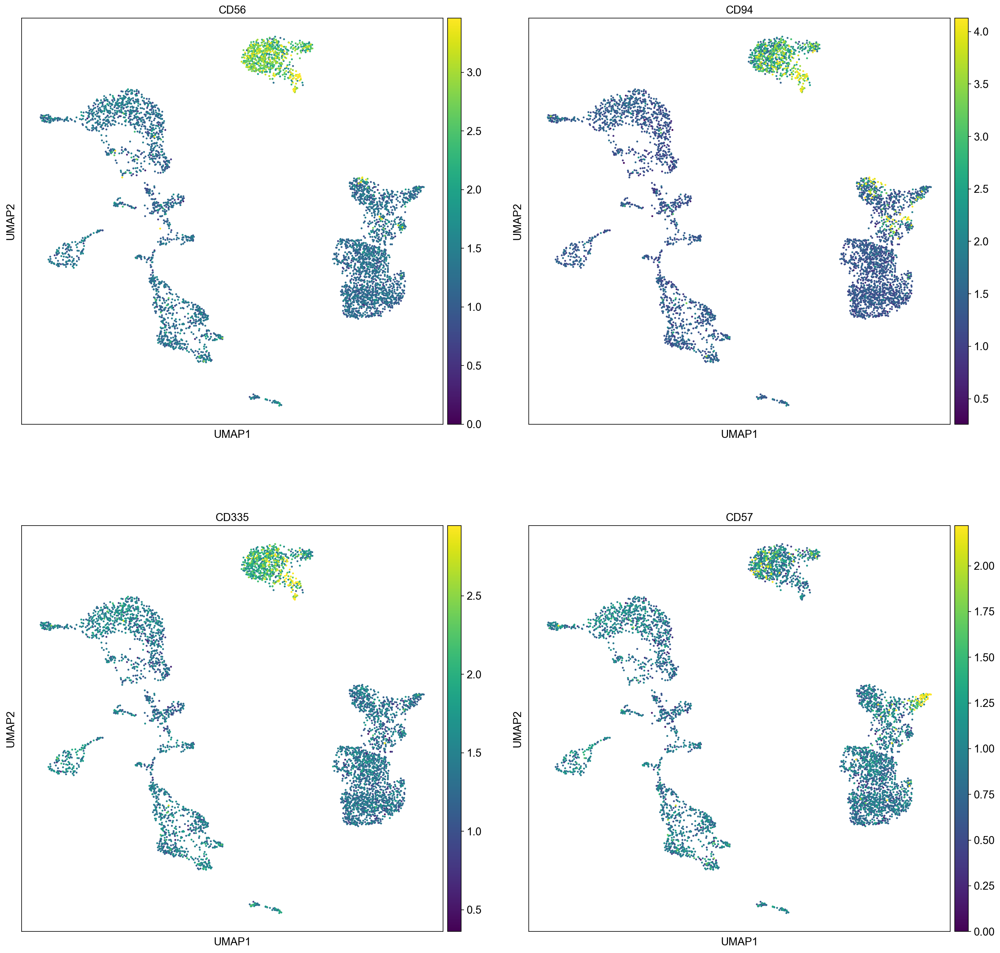

ILC markers, RNA


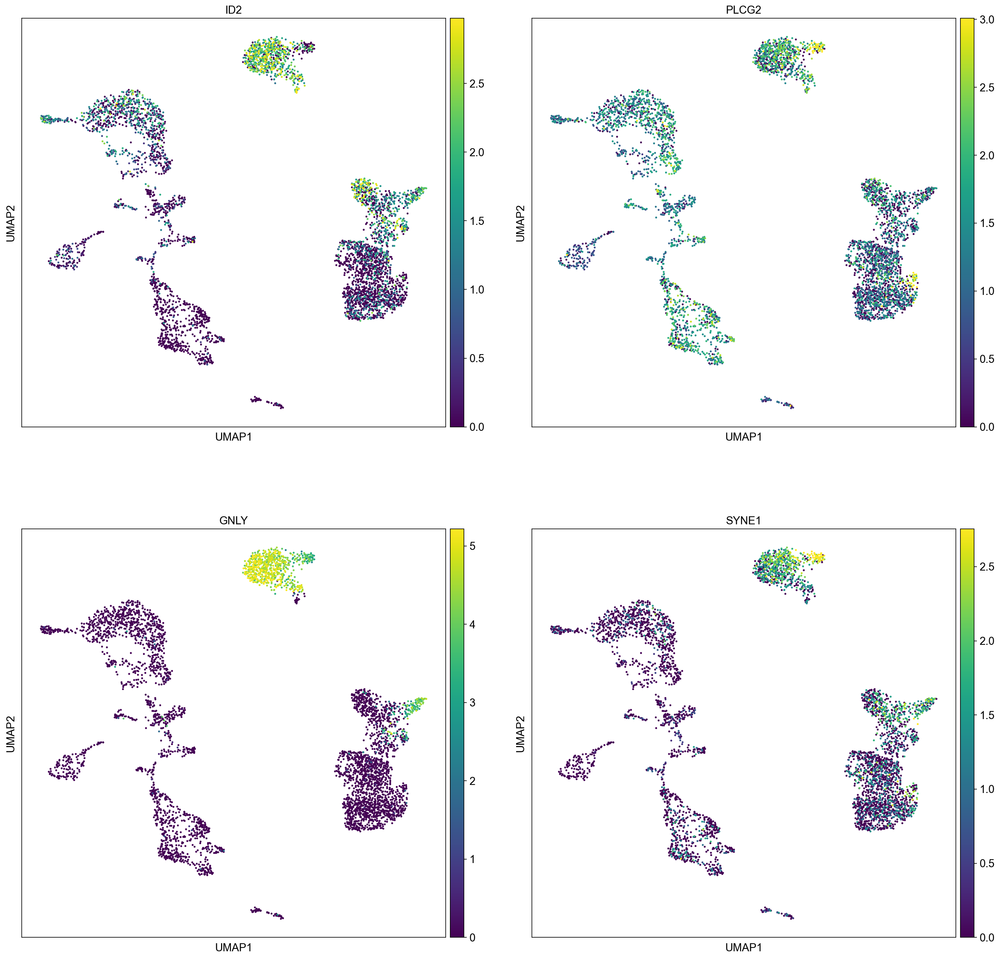

ILC markers, protein


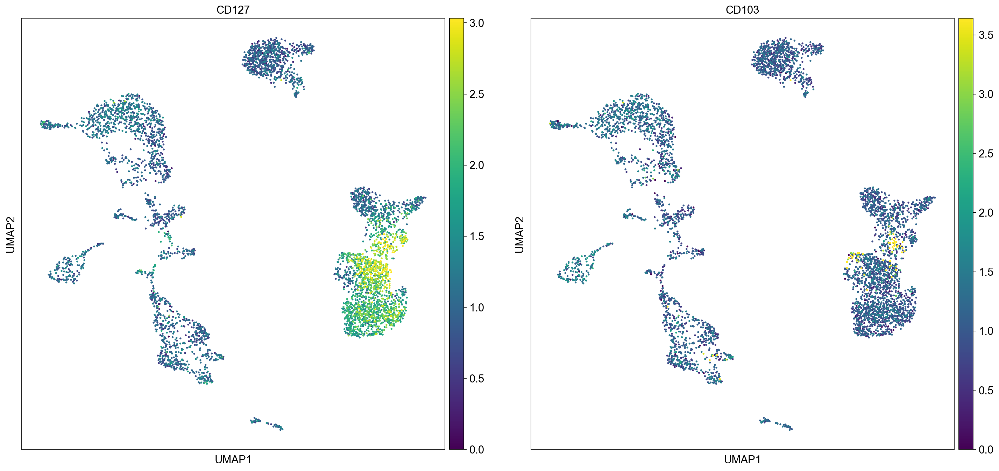

NKT markers, protein


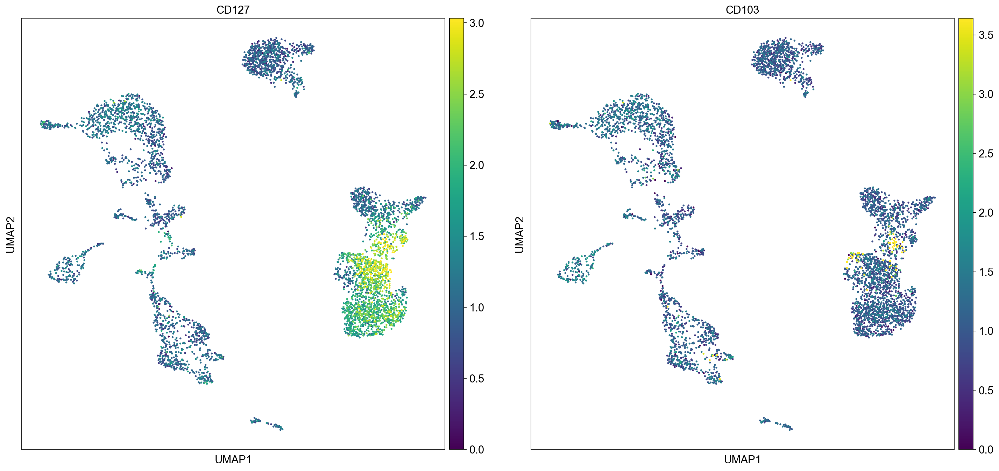

gdT markers, RNA


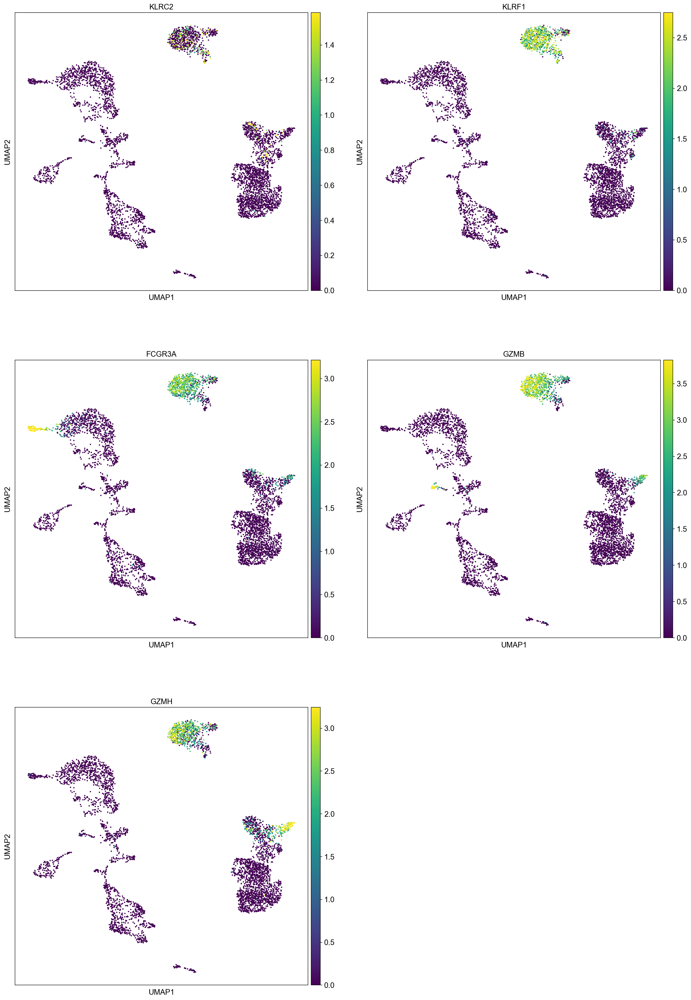

gdT markers, protein


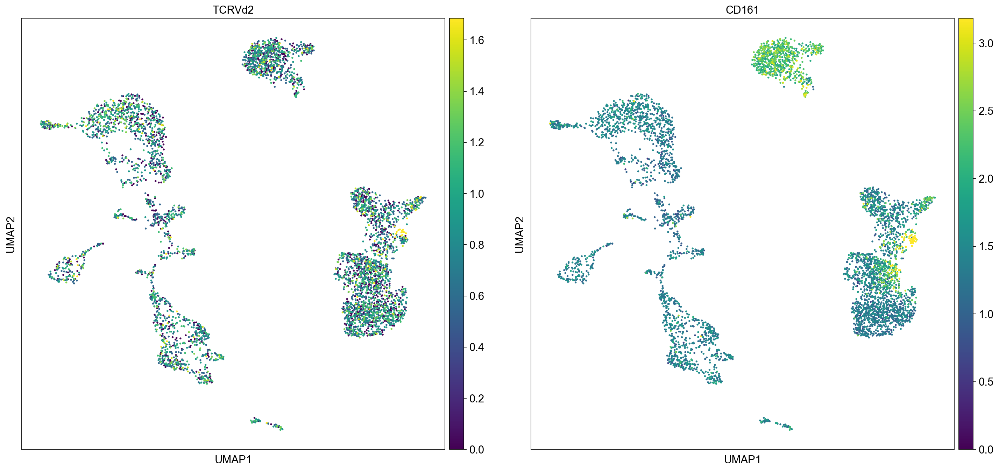

In [25]:
#Markers used in Neurips annotations

nk_rna_neur = ['GNLY', 'NKG7', 'CD247', 'FCER1G', 'TYROBP', 'KLRG1', 'FCGR3A']
nk_prot_neur = ['CD56', 'CD94', 'CD335', 'CD57']

ilc_rna_neur = ['ID2', 'PLCG2', 'GNLY', 'SYNE1']
ilc_prot_neur = ['CD127', 'CD103'] #these markers for different ILCs (ILC1), progenitor like? 

nkt_neur_prot = ['TCRVa7.2']

gdT_rna_neur = ['KLRC2', 'KLRF1', 'FCGR3A', 'GZMB', 'GZMH']
gdT_prot_neur = ['TCRVd2', 'CD161']
    
sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print( "NK markers, RNA")

sc.pl.umap(eg, color = nk_rna_neur, vmax="p99", color_map = 'viridis', ncols=2)

print( "NK markers, protein")
sc.pl.umap(eg, color = nk_prot_neur, vmax="p99", color_map = 'viridis', ncols=2)

print("ILC markers, RNA")
sc.pl.umap(eg, color = ilc_rna_neur, vmax="p99", color_map = 'viridis', ncols=2)

print("ILC markers, protein")
sc.pl.umap(eg, color = ilc_prot_neur, vmax="p99", color_map = 'viridis', ncols=2)

print("NKT markers, protein")
sc.pl.umap(eg, color = ilc_prot_neur, vmax="p99", color_map = 'viridis', ncols=2)

print("gdT markers, RNA")
sc.pl.umap(eg, color = gdT_rna_neur, vmax="p99", color_map = 'viridis', ncols=2)

print("gdT markers, protein")
sc.pl.umap(eg, color = gdT_prot_neur, vmax="p99", color_map = 'viridis', ncols=2)




- Previous markers are collected from Neurips documentation. 
- Results suggest that potential RNA markers for ILCs could be PLCG2 and SYNE1, protein markers appears to be not useful. 
- FCER1G and NKG7 could be useful NK specific markers in separating NK cells and ILCs
- In this sample gd T cells are not locating nearby NK cells. 

##  Melsen et al., (2022) 

Reference: Melsen, J. E., van Ostaijen-Ten Dam, M. M., Schoorl, D. J. A., Schol, P. J., van den Homberg, D. A. L., Lankester, A. C., Lugthart, G., & Schilham, M. W. (2022). Single-cell transcriptomics in bone marrow delineates CD56dimGranzymeK+ subset as intermediate stage in NK cell differentiation. Frontiers in immunology, 13, 1044398. https://doi.org/10.3389/fimmu.2022.1044398 

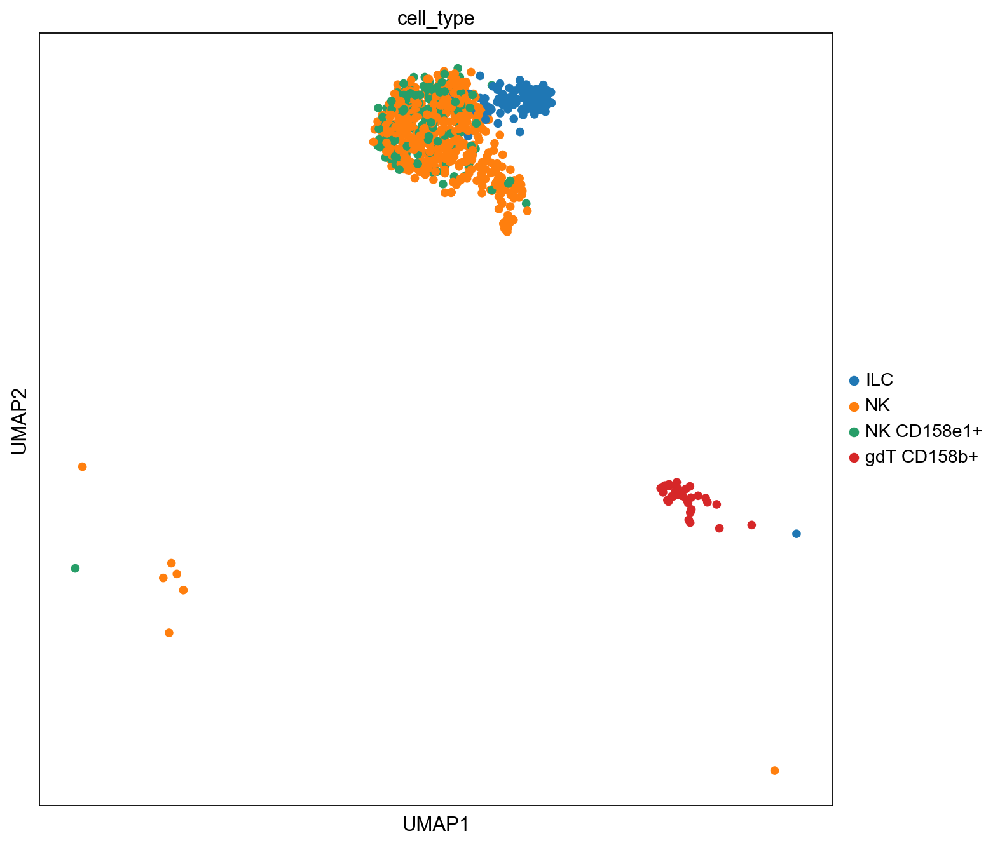

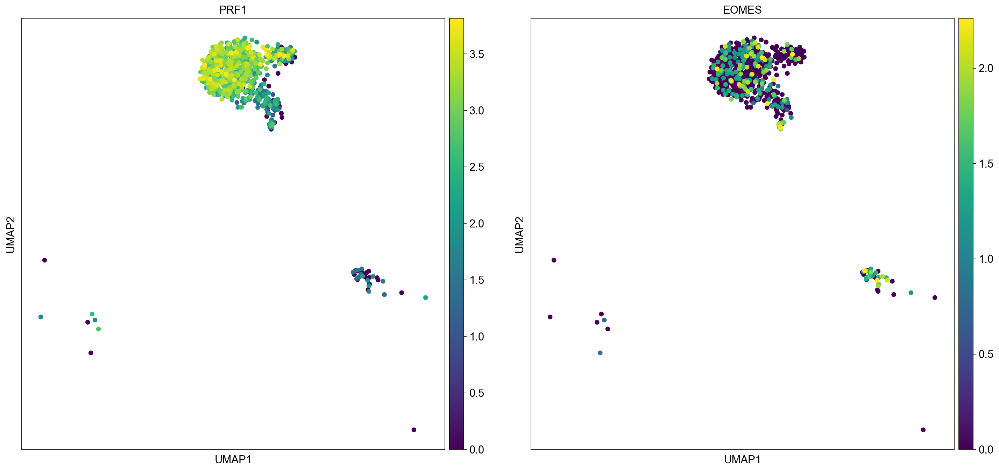

In [26]:
#Separation from ILCs

ilc_sep = ['PRF1', 'EOMES']

#separation from ILCs

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(sample_nk, color = ilc_sep, vmax="p99", color_map = 'viridis', ncols=2)

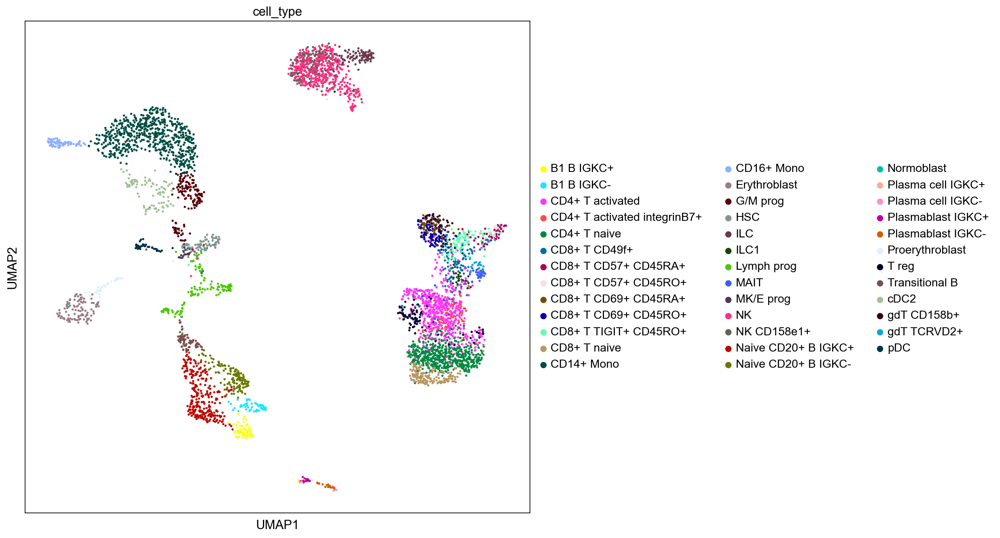

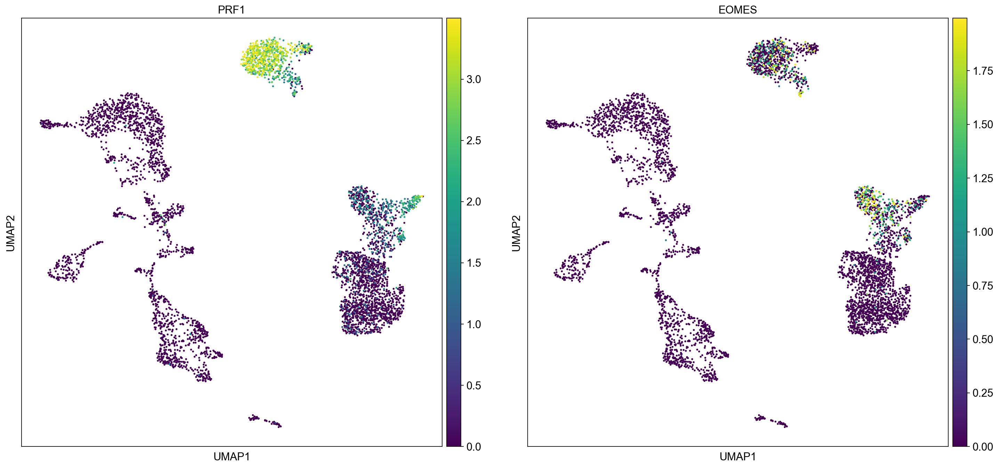

In [27]:
# All cell types

#Separation from ILCs

ilc_sep = ['PRF1', 'EOMES']

#separation from ILCs

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = ilc_sep, vmax="p99", color_map = 'viridis', ncols=2)

## Chiossone et al., ( 2018)

Reference: Chiossone, L., Dumas, P. Y., Vienne, M., & Vivier, E. (2018). Natural killer cells and other innate lymphoid cells in cancer. Nature reviews. Immunology, 18(11), 671–688. https://doi.org/10.1038/s41577-018-0061-z



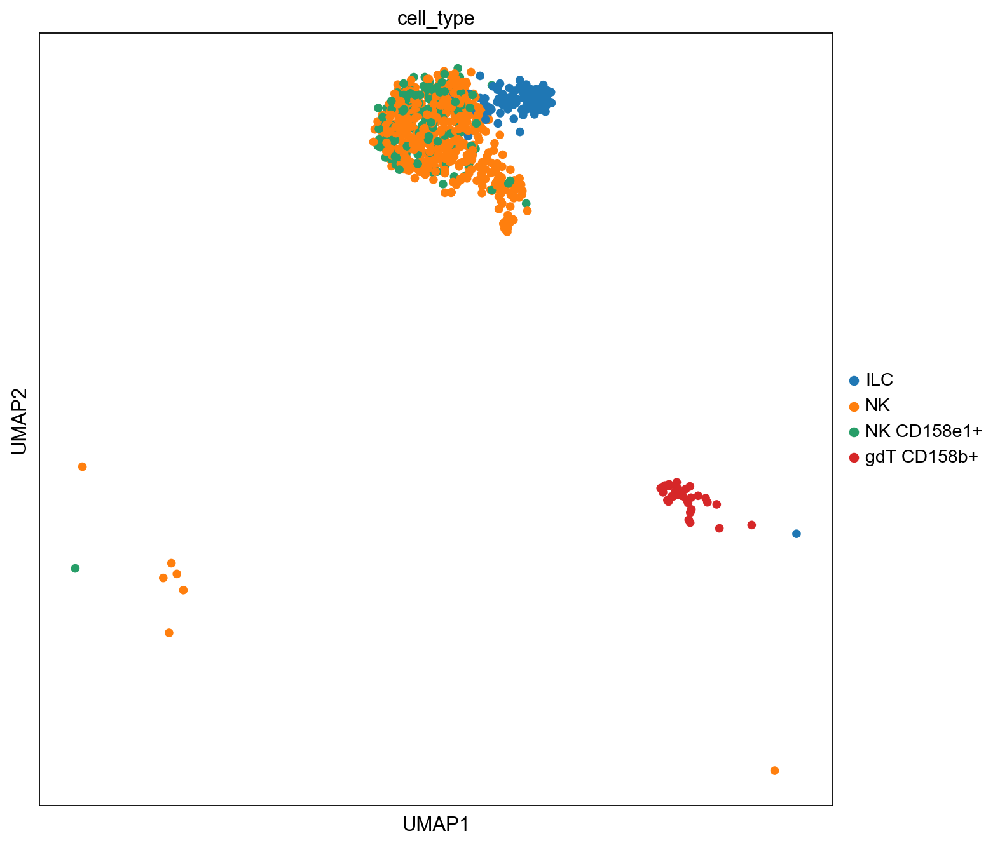

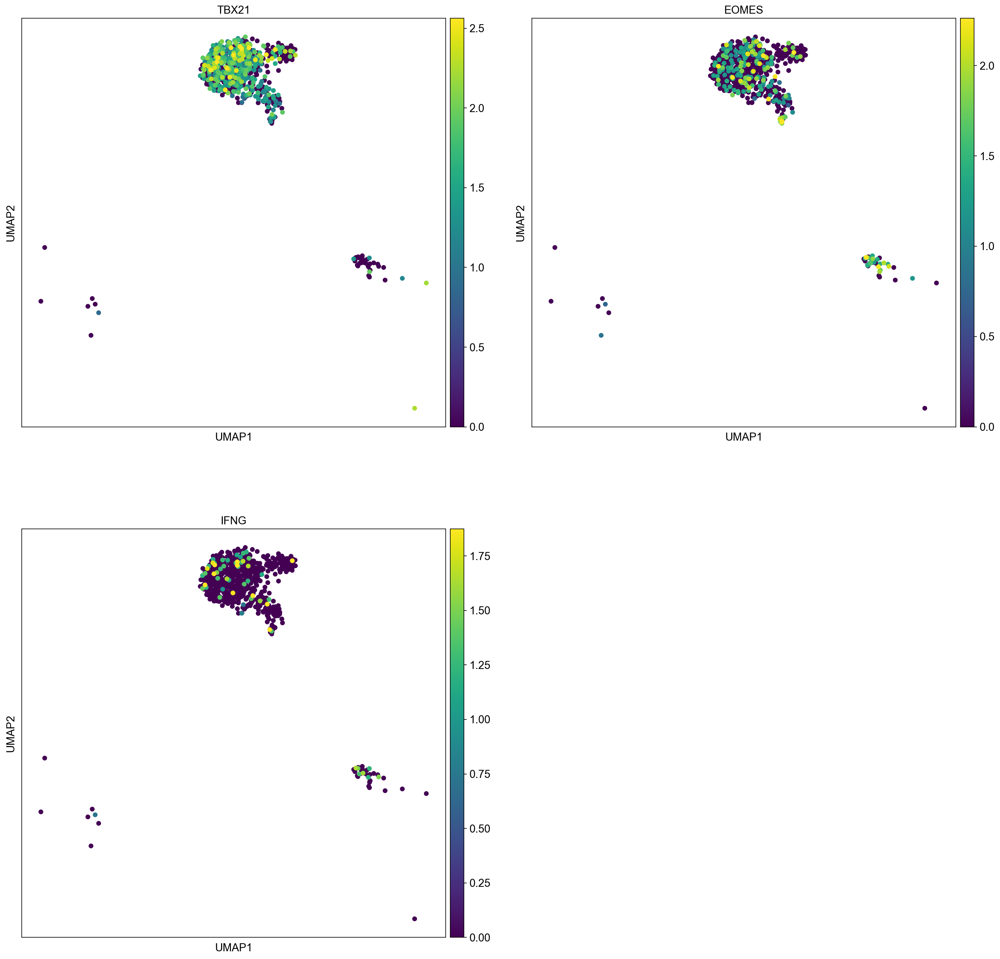

In [28]:
#Group 1 ILC express T-bet (TBX21) and secrete interferon gamma, additionally NK cells express EOMES

#ILC markers

ilc_nk_sep_chiossone = ['TBX21', 'EOMES', 'IFNG']

sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(sample_nk, color = ilc_nk_sep_chiossone , vmax="p99", color_map = 'viridis', ncols=2)





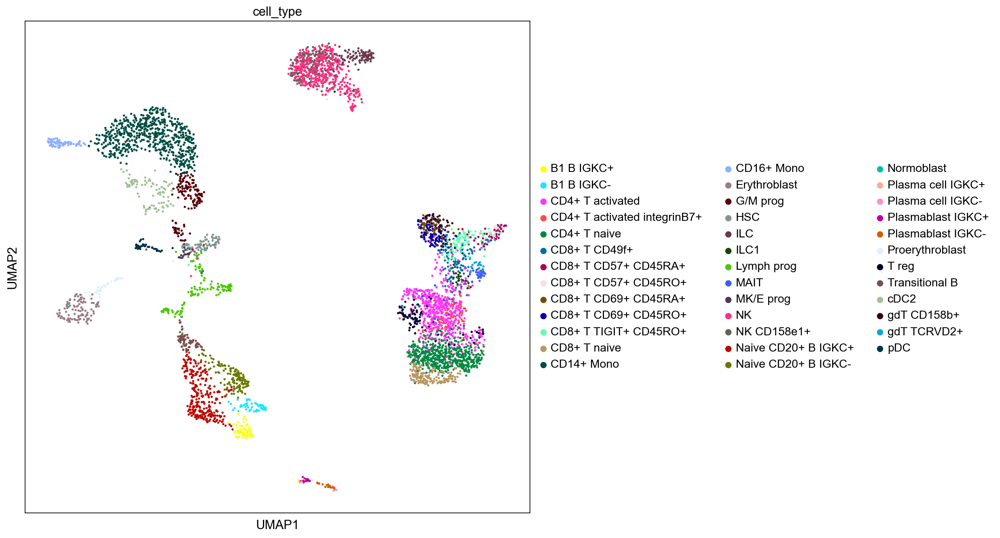

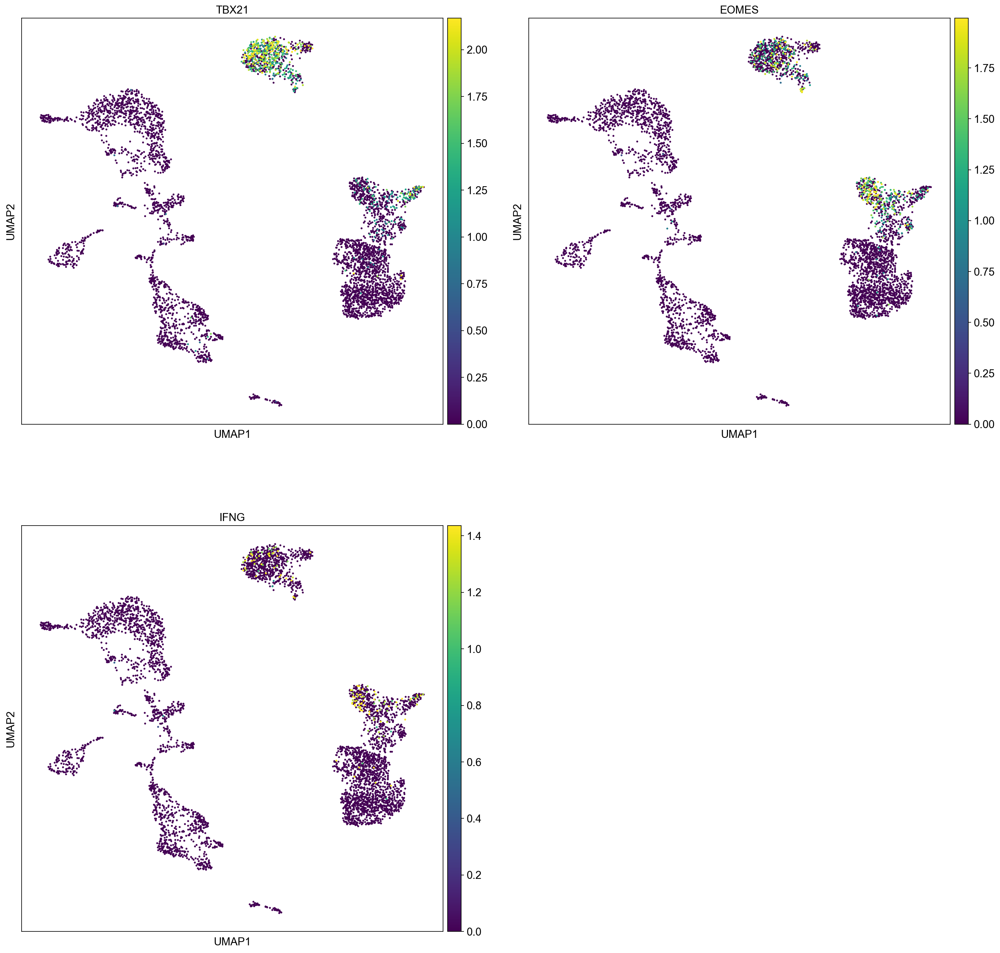

In [29]:
sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = ilc_nk_sep_chiossone , vmax="p99", color_map = 'viridis', ncols=2)



- Although EOMES is mentioned in several papers as a marker to be used to distinguish NK cells and group 1 ILCs, here it is not showing higher expression in NK cells. 

## Serafini et al., (2015)

Reference: Serafini, N., Vosshenrich, C. A., & Di Santo, J. P. (2015). Transcriptional regulation of innate lymphoid cell fate. Nature reviews. Immunology, 15(7), 415–428. https://doi.org/10.1038/nri3855

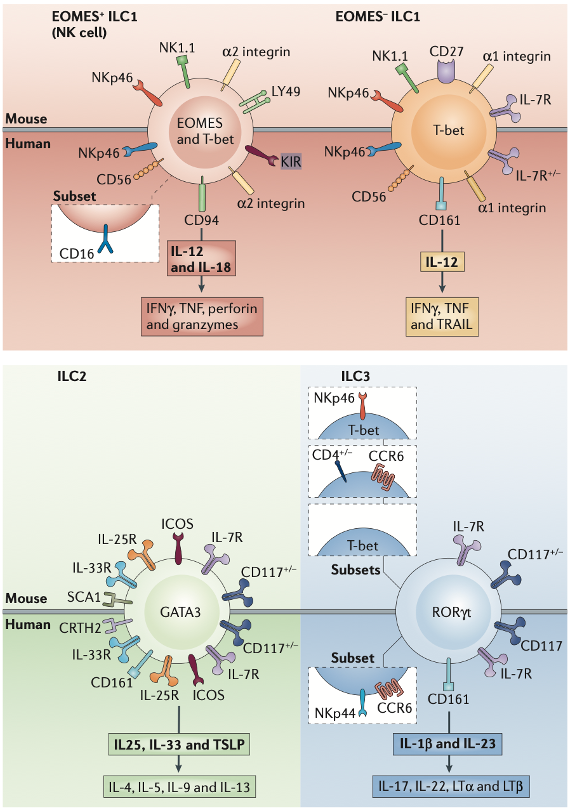

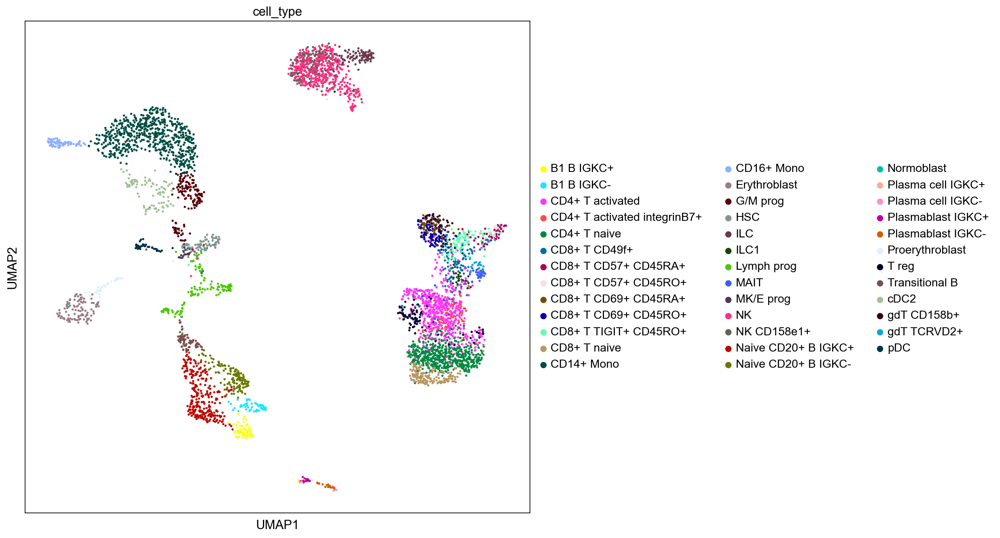

NK cell markers


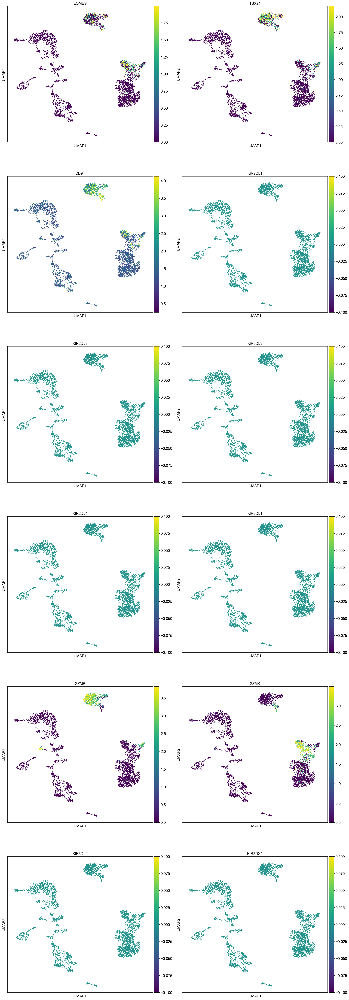

ILC1 markers


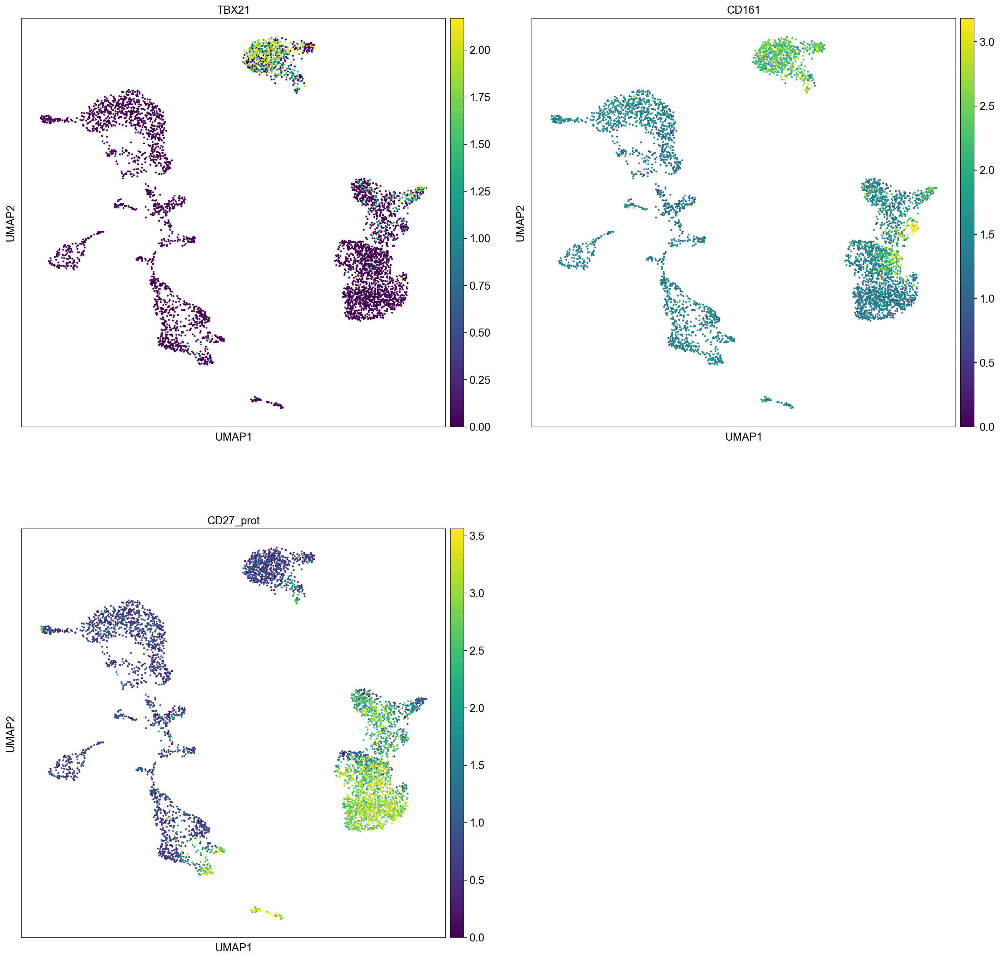

ILC2 markers


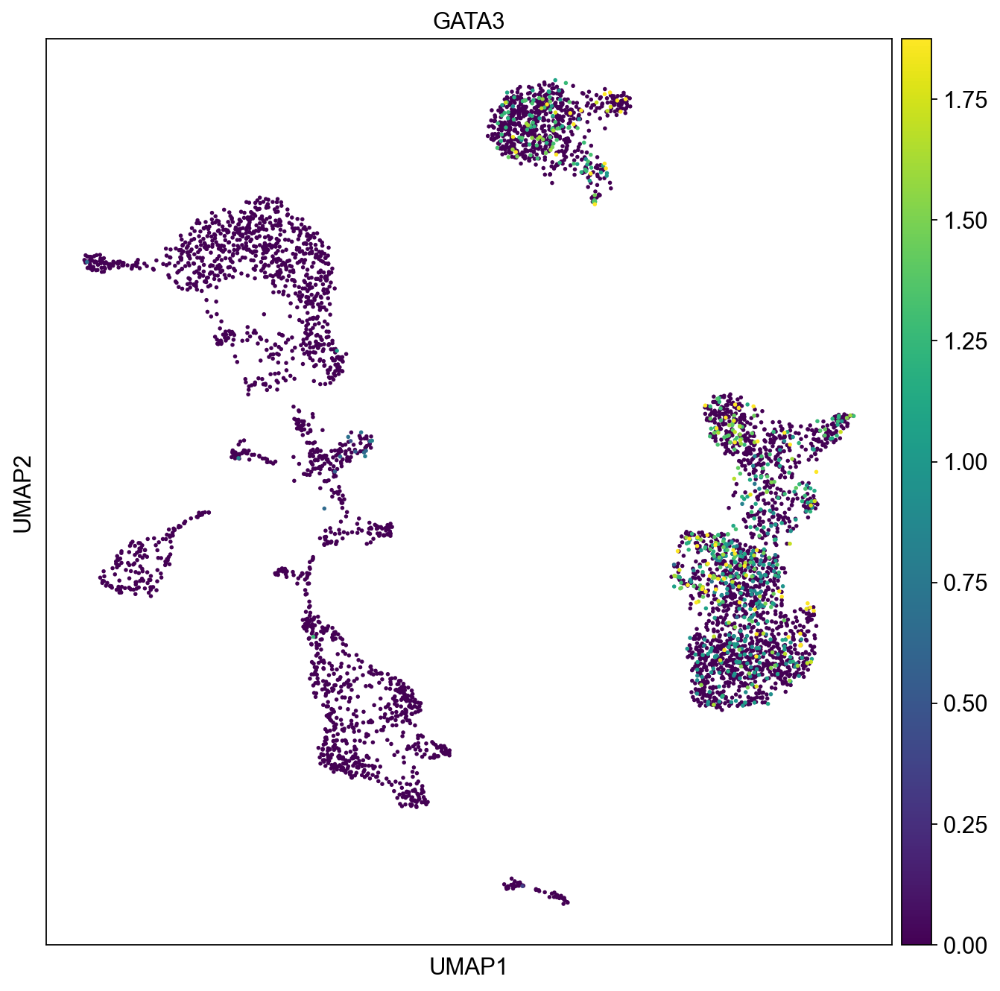

ILC3 markers


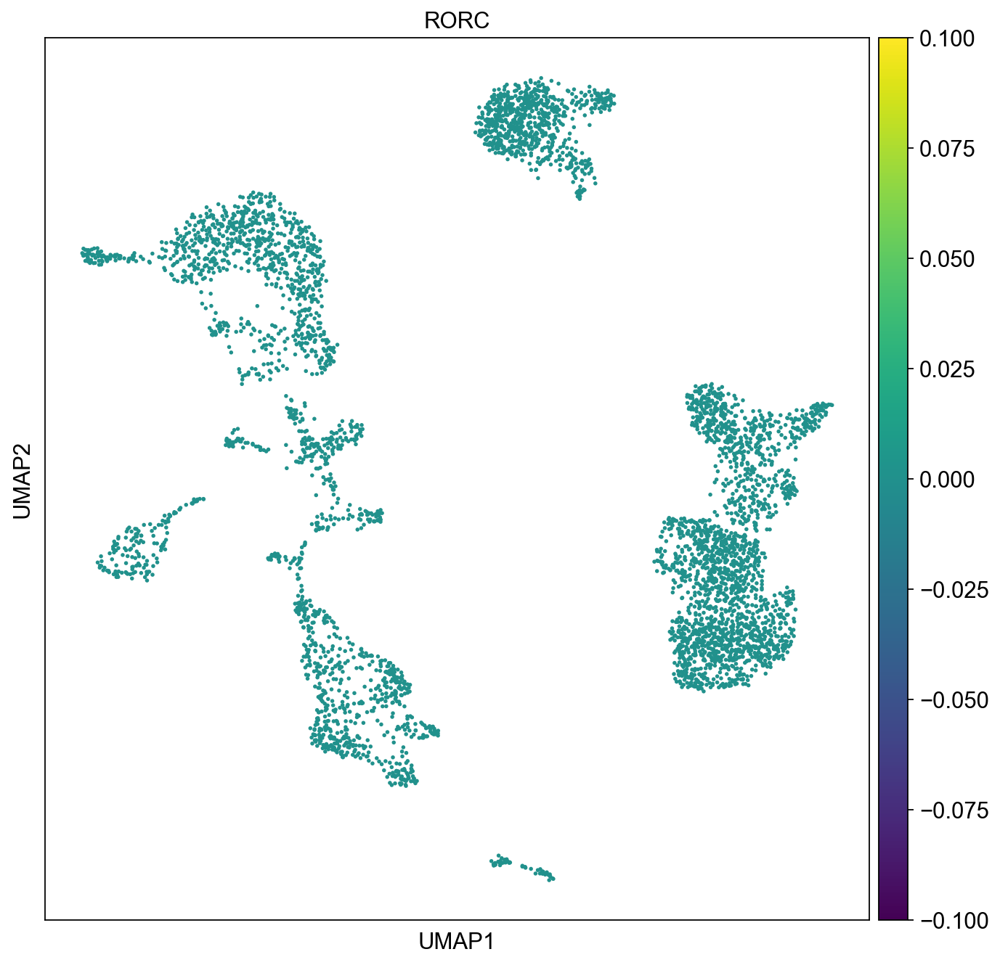

In [30]:
# separation of ILC1, ILC2, ILC3

#EOMES, different KIRs, CD94
nk_serafini = ['EOMES','TBX21', 'CD94', 'KIR2DL1', 'KIR2DL2', 'KIR2DL3', 'KIR2DL4', 'KIR3DL1', 'GZMB', 'GZMK', 'KIR3DL2', 'KIR3DX1'] #NK cells express both

ilc1 = ['TBX21', 'CD161', 'CD27_prot'] # do not express EOMES
ilc2 = ['GATA3']
ilc3 = ['RORC'] 


sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print('NK cell markers')
sc.pl.umap(eg, color = nk_serafini , vmax="p99", color_map = 'viridis', ncols=2)

print('ILC1 markers')
sc.pl.umap(eg, color = ilc1 , vmax="p99", color_map = 'viridis', ncols=2)

print('ILC2 markers')
sc.pl.umap(eg, color = ilc2 , vmax="p99", color_map = 'viridis', ncols=2)

print('ILC3 markers')
sc.pl.umap(eg, color = ilc3 , vmax="p99", color_map = 'viridis', ncols=2)



## Freud et al. (2017)

Reference: Freud, A. G., Mundy-Bosse, B. L., Yu, J., & Caligiuri, M. A. (2017). The Broad Spectrum of Human Natural Killer Cell Diversity. Immunity, 47, 820–833. https://doi.org/10.1016/j.immuni.2017.10.008

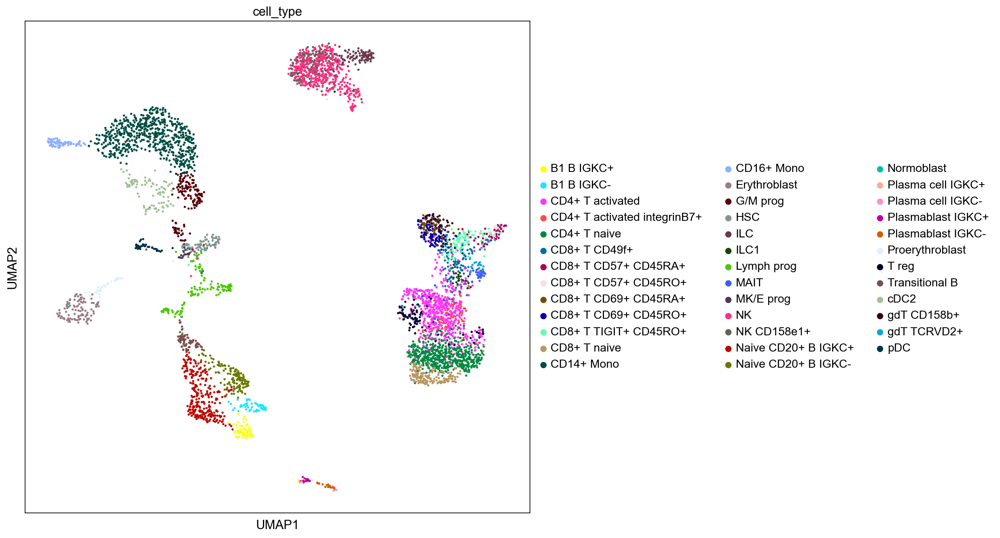

NK cell markers


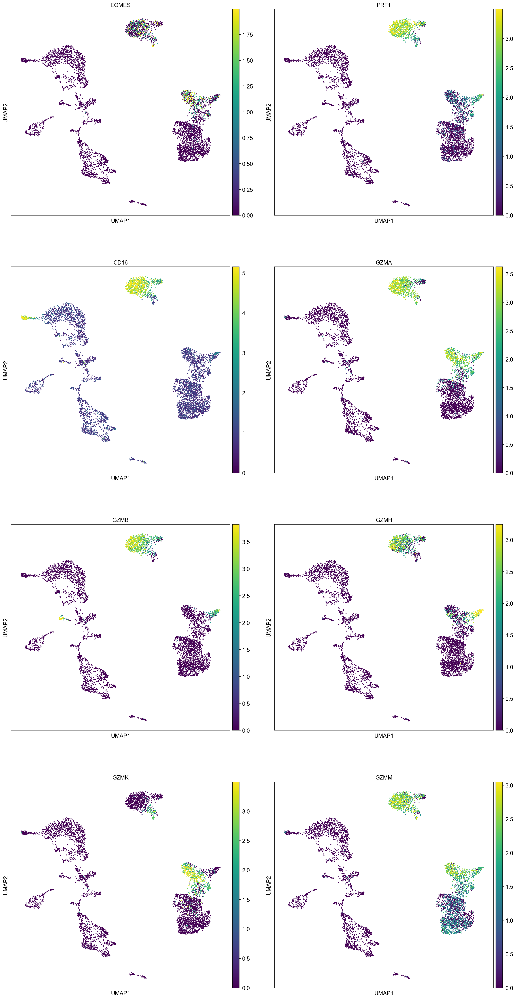

In [31]:
nk_ilc_sep_freud = ['EOMES', 'PRF1', 'CD16', 'GZMA', 'GZMB', 'GZMH', 'GZMK', 'GZMM']

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

print('NK cell markers')
sc.pl.umap(eg, color = nk_ilc_sep_freud , vmax="p99", color_map = 'viridis', ncols=2)

## Separation from gd T cells, T cell receptors

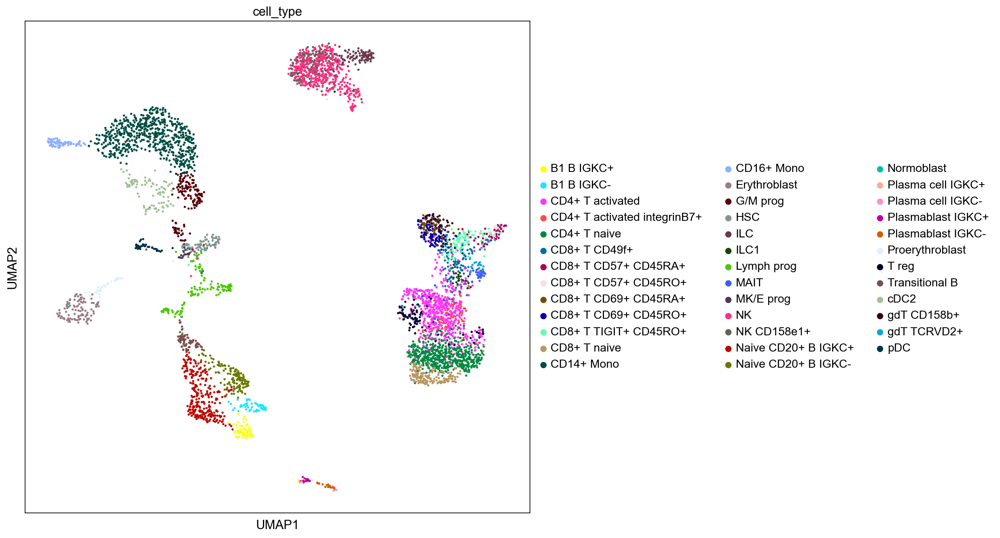

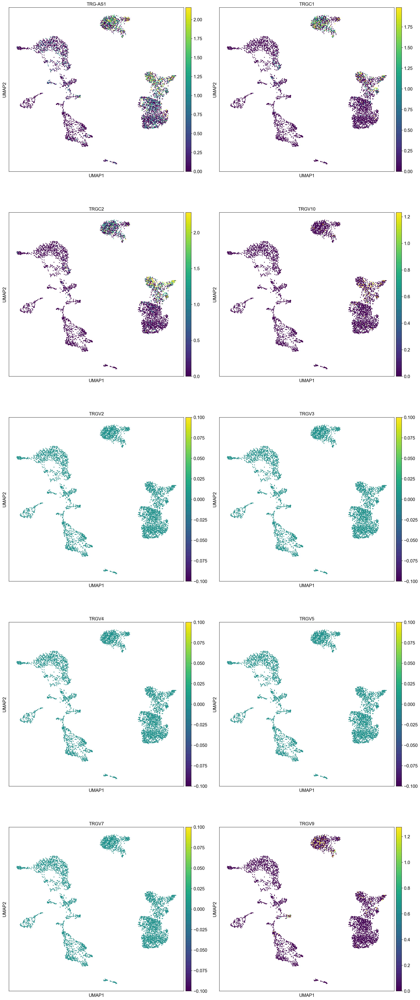

In [32]:
# Gamma chains

gamma_sep = ['TRG-AS1', 'TRGC1', 'TRGC2', 'TRGV10', 'TRGV2', 'TRGV3', 'TRGV4', 'TRGV5', 'TRGV7', 'TRGV9']

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = gamma_sep, vmax="p99", color_map = 'viridis', ncols=2)

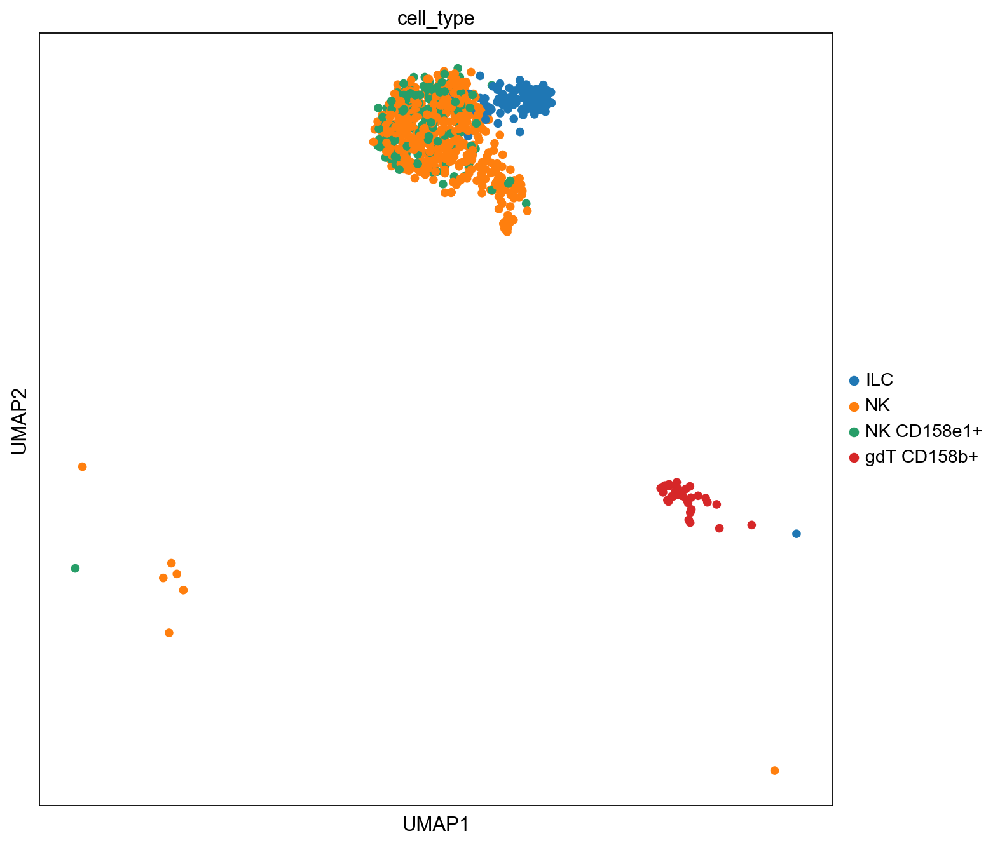

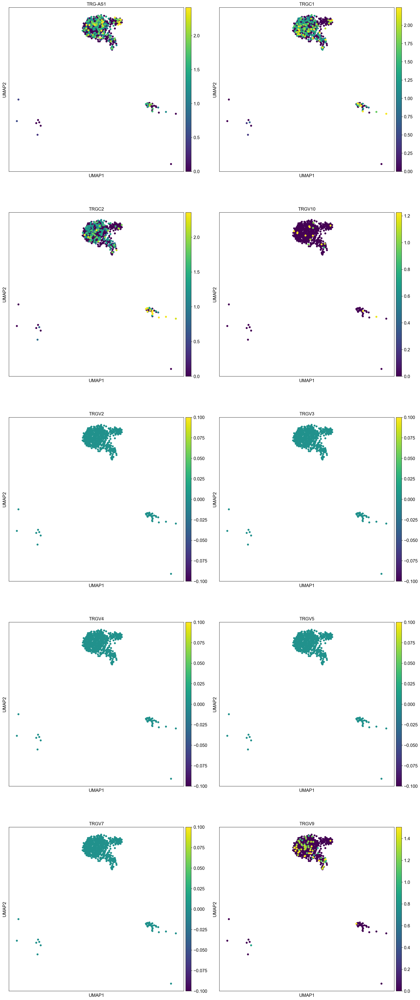

In [33]:
sc.pl.umap(sample_nk, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(sample_nk, color = gamma_sep, vmax="p99", color_map = 'viridis', ncols=2)

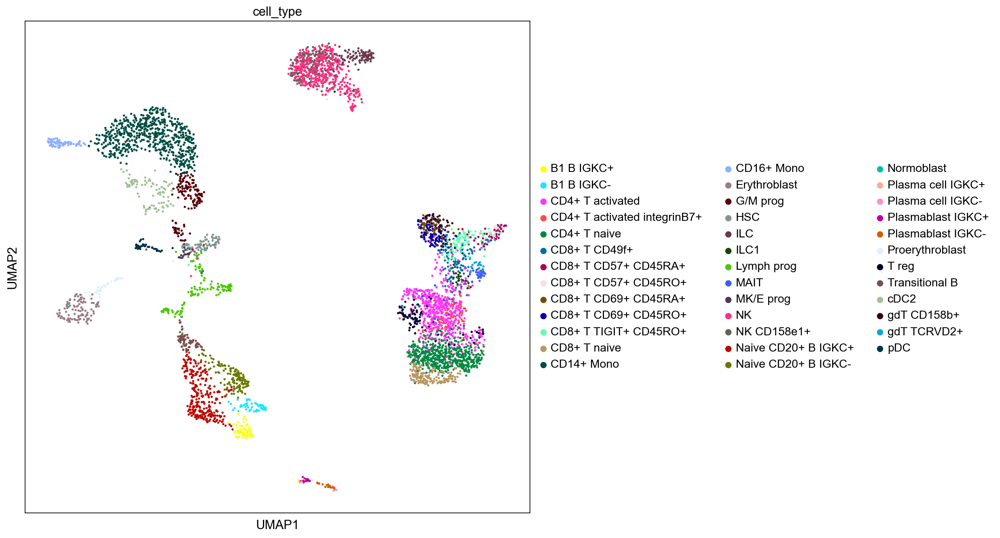

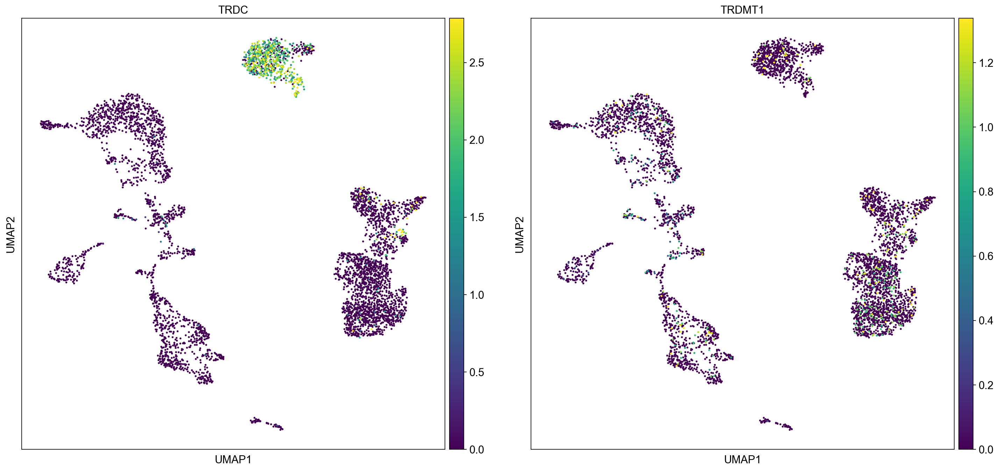

In [34]:
#Delta chains

delta_sep = ['TRDC', 'TRDMT1']

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = delta_sep, vmax="p99", color_map = 'viridis', ncols=2)

- Above genes encoding gamma (TRG) and delta (TRD) chains are tested. Not all genes encoding gamma chains were tested in this dataset (no expression seen in few UMAPs). 

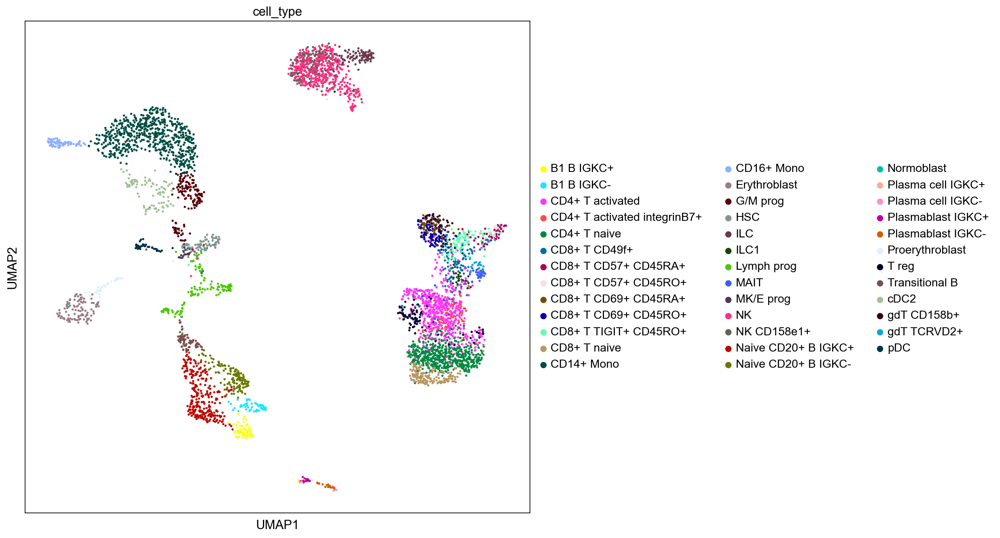

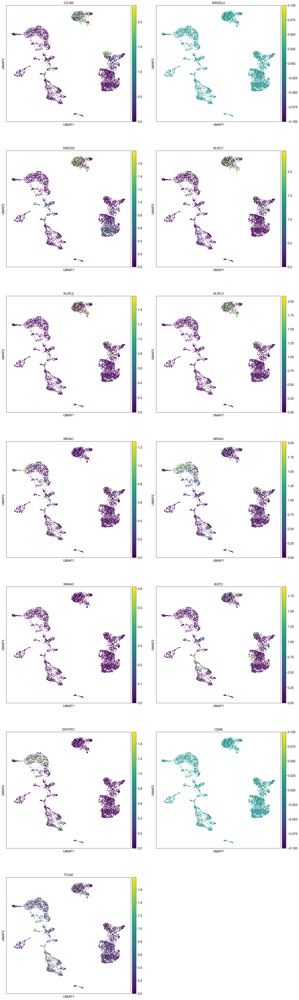

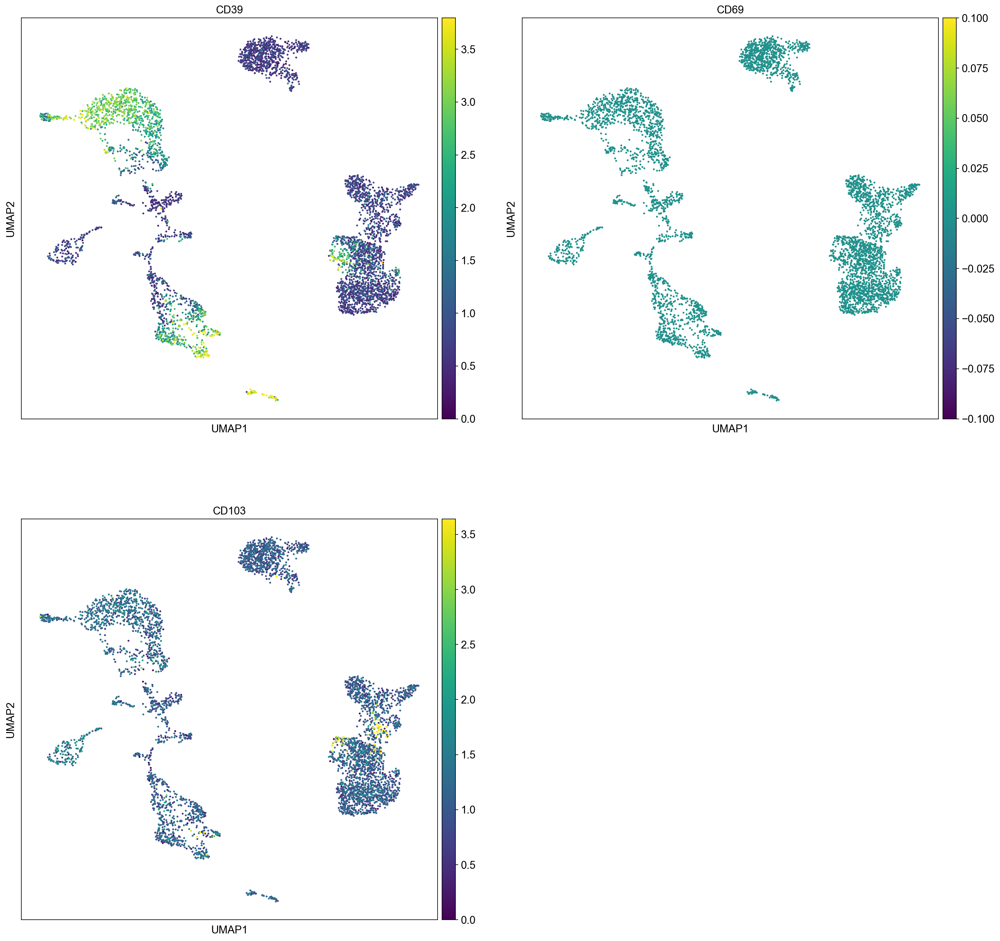

In [40]:
#Markers from papwer by Zhahn et al. (2018)

#["CD160", "KIR2DL4(CD158D)", "TMIGD2(CD28H)", "KLRC1", "KLRC2(CD159c)", "KLRC3", "NR4A1", "NR4A2", "NR4A3", "IKZF2", "ENTPD1(CD39)", "CD69", "ITGAE(CD103)"]

IEL = ["CD160", "KIR2DL4", "TMIGD2", "KLRC1", "KLRC2", "KLRC3", "NR4A1", "NR4A2", "NR4A3", "IKZF2", "ENTPD1", "CD69", "ITGAE"]
IEL_prot = ['CD39', 'CD69', 'CD103'] #CD158d, CD28H, CD159c not used

sc.pl.umap(eg, color = ['cell_type'], vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = IEL, vmax="p99", color_map = 'viridis', ncols=2)

sc.pl.umap(eg, color = IEL_prot, vmax="p99", color_map = 'viridis', ncols=2)